# MileStone 2: Data Collection and Description

We will explore two different set of datasets:

* GBD dataset, which will contain the measures for each mental disease per geographic area we can find
* We will explore the five continents - Europe, Asia, America, Africa, Oceania
* We also choose to explore the 3 representative countries from 3 largest continents - Russia, China, France, Australia and United States

This project aims to understand the effect of mental disorders on people's life by measuring their impact and the percentage of people attained by the mental disorders.

We first clean the data by selecting the columns of the data set we want to read, then we will explore each dataset separately.


## The GBD Dataset

We made several queries using the [GBD query tool](http://ghdx.healthdata.org/gbd-results-tool), selecting all mental disorders for all ages in these countries. These queries return us the necessary csv files. We after cleaning all unnecessary datas, we are left with 3 csvs with all the essential datas we need. To save time, we will solely work with these csv (instead of the original 5GB dataset).

In [80]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns
from enum import Enum
import numpy as np
import json
import folium
from branca.colormap import LinearColormap, StepColormap
from matplotlib.legend import Legend
import itertools

In [81]:
# define constant numbers
ONE_MILLION = 1000000

In [82]:
data_folder = "./data/"
reading_folder = "./data/Last_data/"
saving_folder = "./data/Last_data/"
file_list = [i for i in sorted(os.listdir(reading_folder)) if 'IHME-GBD' in i]

In [83]:
pdfs = []
for file in file_list:
    print("Reading {} ...".format(file))
    pdfs.append(pd.read_csv(reading_folder + file))

Reading IHME-GBD_2017_DATA-1a98c9fa-1.csv ...
Reading IHME-GBD_2017_DATA-1a98c9fa-2.csv ...
Reading IHME-GBD_2017_DATA-1a98c9fa-3.csv ...


### Data Cleaning

We decided to split the dataset according to different measures - Prevalence, Deaths and DALY. We then save them into separately.

In [84]:
# Merge into one huge data matrix
pd_all = pd.concat(pdfs).reset_index(drop=True)
pd_all.shape

(1238160, 10)

Here is what the data looks like: 

In [85]:
pd_all.head()

,measure,location,sex,age,cause,metric,year,val,upper,lower
0,Prevalence,France,Male,1 to 4,Depressive disorders,Number,1990,0.0,0.0,0.0
1,Prevalence,France,Female,1 to 4,Depressive disorders,Number,1990,0.0,0.0,0.0
2,Prevalence,France,Both,1 to 4,Depressive disorders,Number,1990,0.0,0.0,0.0
3,Prevalence,France,Male,1 to 4,Depressive disorders,Rate,1990,0.0,0.0,0.0
4,Prevalence,France,Female,1 to 4,Depressive disorders,Rate,1990,0.0,0.0,0.0


In [86]:
# Get all measure names
measure_names = pd_all.measure.unique()
# Group by and get all groups
groups_by = pd_all.groupby('measure')
measure_groups = dict.fromkeys(measure_names)
for measure in measure_names:
    measure_groups[measure] = groups_by.get_group(measure)
    
# Save the groups in csv
for measure in measure_names:
    filename = saving_folder+measure+".csv"
    print("Saving {} to {}".format(measure, filename))
    #measure_groups[measure].to_csv(filename, compression="zip")
    measure_groups[measure].to_csv(filename)

Saving Prevalence to ./data/Last_data/Prevalence.csv
Saving DALYs (Disability-Adjusted Life Years) to ./data/Last_data/DALYs (Disability-Adjusted Life Years).csv
Saving Deaths to ./data/Last_data/Deaths.csv


### Exploring by DALY

DALYs equal the sum of years of life lost (YLLs) and years lived with disability (YLDs). DALYs allow us to estimate the total number of years lost due to specific causes and risk factors at the country, regional, and global levels.
One DALY can be thought of as one lost year of "healthy" life. The sum of these DALYs across the population, or the burden of disease, can be thought of as a measurement of the gap between current health status and an ideal health situation where the entire population lives to an advanced age, free of disease and disability.

In [87]:
DALY = pd.read_csv(saving_folder + "DALYs (Disability-Adjusted Life Years).csv", index_col=0, low_memory=False).dropna()
DALY.year = DALY.year.astype(int)
DALY.head()

,measure,location,sex,age,cause,metric,year,val,upper,lower
24576,DALYs (Disability-Adjusted Life Years),Oceania,Male,1 to 4,Depressive disorders,Number,1990,0.971585,1.930318,0.424445
24577,DALYs (Disability-Adjusted Life Years),Oceania,Female,1 to 4,Depressive disorders,Number,1990,0.986340,1.969994,0.433837
24578,DALYs (Disability-Adjusted Life Years),Oceania,Both,1 to 4,Depressive disorders,Number,1990,1.957925,3.873068,0.861491
24579,DALYs (Disability-Adjusted Life Years),Oceania,Male,1 to 4,Depressive disorders,Rate,1990,0.243385,0.483551,0.106325
24580,DALYs (Disability-Adjusted Life Years),Oceania,Female,1 to 4,Depressive disorders,Rate,1990,0.264145,0.527570,0.116183


In [88]:
# Rename the column 5-9 for easier ordering later
DALY.age = DALY.age.replace({'5 to 9':'05 to 09', '1 to 4':'01 to 04'})
# These are the ages we will look at
DALY.age.unique()

array(['01 to 04', '05 to 09', '10 to 14', '15 to 19', '20 to 24',
       '25 to 29', '30 to 34', '35 to 39', '40 to 44', '45 to 49',
       '50 to 54', '55 to 59', '60 to 64', '65 to 69', '70 to 74',
       '75 to 79', 'All Ages', '80 to 84', '85 to 89', '90 to 94',
       '95 plus'], dtype=object)

In [89]:
# These are the locations we will look at
DALY.location.unique()

array(['Oceania', 'Global', 'China', 'Russian Federation', 'Australia',
       'United States', 'America', 'Africa', 'Asia', 'France', 'Europe'],
      dtype=object)

In [90]:
# These are the mental illness we will look at
DALY.cause.unique()

array(['Depressive disorders', 'Major depressive disorder', 'Dysthymia',
       'Bipolar disorder', 'Anxiety disorders', 'Eating disorders',
       'Anorexia nervosa', 'Bulimia nervosa', 'Autism spectrum disorders',
       'Attention-deficit/hyperactivity disorder', 'Conduct disorder',
       'Idiopathic developmental intellectual disability',
       'Other mental disorders', 'Mental disorders', 'Schizophrenia'],
      dtype=object)

When we take a look at causes, we realize that some of these diseases overlap. For example, mental disorders is a header cause that is essentially just a grouped aggregation of other causes. In total, based on the query we used to obtain this data, there are four levels of causes. We will only use the first two levels because the last level is extremely specific and out of the scope of this project. We therefore create two lists of levels. If we want to look at mental disorders prevalence as a whole, we can filter by cause_name in level_1. If we want to group by more specific cause_types or dig deeper into a specific cause, we can filter by cause_name in level_2. Finally, on the fourth level, depression and eating disorders each have distinct sub-mental disorders.

In [91]:
# For when splitting the dataset per measure
class Measure(Enum):
    NUMBER = 1
    RATE = 2
    PERCENT = 3

def get_data_per_locations(locations, dataset, measure):
    """Returns a dictionary per country for the dataset, the measureand the locations selected"""
    data_per_country = dict.fromkeys(locations)
    
    if measure == Measure.NUMBER:
        data = dataset.loc[dataset.metric == 'Number']
    elif measure == Measure.RATE:
        data = dataset.loc[dataset.metric == 'Rate']
    else:
        raise Exception('Error: Unknown measure {} !'.format(measure))

    for location in locations:
        data_per_country[location] = data[(data.location == location)].sort_values(by='year')
    
    return data_per_country

We had to manually list the continents, because there wasn't a way to separate them from the dataset from the rest of the countries. We had to do the same for the list of mental illnesses. However, once we splitted manually the main mental diseases/ continents, we could separate the rest with code.

In [92]:
# Categorize the mental illness
# 'Mental disorders' is level 1 because it is an aggregation of all the level 2 causes.
level_1 = ['Mental disorders']
depression = ['Major depressive disorder', 'Dysthymia']
eating = ['Anorexia nervosa', 'Bulimia nervosa']
level_2 = [i for i in DALY.cause.unique() if (i not in level_1) and (i not in depression) and (i not in eating) ]

class Cause(Enum):
    LEVEL_1 = "Mental disorders"
    LEVEL_2 = "Type of mental disorders"
    DEPRESSION = "Depressive disorders"
    EATING = "Eating disorders"

# Categorize the countries
glob = ['Global']
continents = ['Asia', 'Europe', 'Oceania', 'America', 'Africa']
countries = [ i for i in sorted(DALY.location.unique()) if ((not i in continents) and (i != 'Global'))]

class Location(Enum):
    GLOBAL = "Global"
    CONTINENT = "Continents"
    COUNTRY = "Country"

# Get data for each measure per country and per continent
DALY_rate_global = get_data_per_locations(glob, DALY, Measure.RATE)
DALY_number_global = get_data_per_locations(glob, DALY, Measure.NUMBER)
DALY_rate_per_country = get_data_per_locations(countries, DALY, Measure.RATE)
DALY_rate_per_continent = get_data_per_locations(continents, DALY, Measure.RATE)
DALY_number_per_country = get_data_per_locations(countries, DALY, Measure.NUMBER)
DALY_number_per_continent = get_data_per_locations(continents, DALY, Measure.NUMBER)

#### DALY per sex and location over time

This section will look at the evolution of percentage of DALY (calulated by number of DALY at location / sum of DALY at all locations) per sex for each continen, each country (we will select only China for this notebook, but the process is the same for other selected countries) for each level of mental illness over 1990-2017.

In [93]:
def plot_DALY_per_sex_country(country='China', location_lvl=Location.COUNTRY, age='All Ages', cause_name=Cause.LEVEL_2, measure = Measure.PERCENT):
    """Plot DALY measure over time per sex for a specific country"""
    # Choose measure
    if measure == Measure.NUMBER or measure == Measure.PERCENT:
        # Choose location
        if location_lvl == Location.GLOBAL:
            df_country = DALY_number_global[country]
        elif location_lvl == Location.CONTINENT:
            df_country = DALY_number_per_continent[country]
        elif location_lvl == Location.COUNTRY:
            df_country = DALY_number_per_country[country]
        else:
            raise Exception("Wrong level!")
        measure_name = "number"
    elif measure == Measure.RATE:
        if location_lvl == Location.GLOBAL:
            df_country = DALY_rate_global[country]
        elif location_lvl == Location.CONTINENT:
            df_country = DALY_rate_per_continent[country]
        elif location_lvl == Location.COUNTRY:
            df_country = DALY_rate_per_country[country]
        else:
            raise Exception("Wrong level!")
        measure_name = "Rate per 100 000 people"
        
    # Choose cause
    if cause_name == Cause.LEVEL_1:
        cause = sorted(level_1)
    elif cause_name == Cause.LEVEL_2:
        cause = sorted(level_2)
    elif cause_name == Cause.DEPRESSION:
        cause = sorted(depression)
    else:
        cause = sorted(eating)
    
    # Split according to gender and standardize
    df_country_female = df_country[(df_country.sex.isin(['Female'])) & (df_country.age == age) & (df_country.cause.isin(cause))].groupby(['year', 'cause'])['val'].sum().unstack()    
    df_country_male = df_country[(df_country.sex.isin(['Male'])) & (df_country.age == age) & (df_country.cause.isin(cause))].groupby(['year', 'cause'])['val'].sum().unstack()
    if measure == Measure.PERCENT:
        df_country_female = df_country_female.apply(lambda x: x/x.sum() * 100, axis=1)
        df_country_male = df_country_male.apply(lambda x: x/x.sum() * 100, axis=1)
        measure_name = "ratio"
   
    df_country_over_years = df_country[(df_country.sex == 'Both') & (df_country.age == age) & (df_country.cause.isin(cause))].groupby(['year', 'cause'])['val'].sum().unstack()

    fig, axes = plt.subplots(figsize=(20, 15), ncols=1, nrows=2)
    width = 0.35
    # Different plotting methode according to levels of mental illness
    sexes = sorted([i for i in df_country.sex.unique() if i != 'Both'])
    if cause == level_1:
        df_country_female.plot.bar(stacked=True, ax=axes[0], grid=True, width=width, position=0, color="Red", rot=0, legend=False)
        df_country_male.plot.bar(stacked=True, ax=axes[0], grid=True, width=width, position=1, rot=0, legend=False, title="DALY {} caused by {} per sex in {}".format(measure_name, cause_name.value, country))
        legend_df = sexes
    else:
        df_country_female.plot.bar(stacked=True, ax=axes[0], grid=True, width=width, colormap='spring', position=0, rot=0, legend=False)
        df_country_male.plot.bar(stacked=True, ax=axes[0], grid=True, width=width, colormap='winter' , position=1, rot=0, legend=False, title="DALY {} caused by {} per sex in {}".format(measure_name, cause_name.value, country))
        cause_sex = list(itertools.product(sexes, cause))
        legend_df = [i + " - " + j for i,j in cause_sex]
    
    axes[0].legend(legend_df, loc='center left', bbox_to_anchor=(1, 0.5))
    
    df_country_over_years.plot(ax=axes[1], grid=True, title="DALY {} caused by {} over time in {} (1990-2017)".format(measure_name, cause_name.value, country))
    axes[1].xaxis.set_ticks(df_country.year.unique())
    plt.show() 

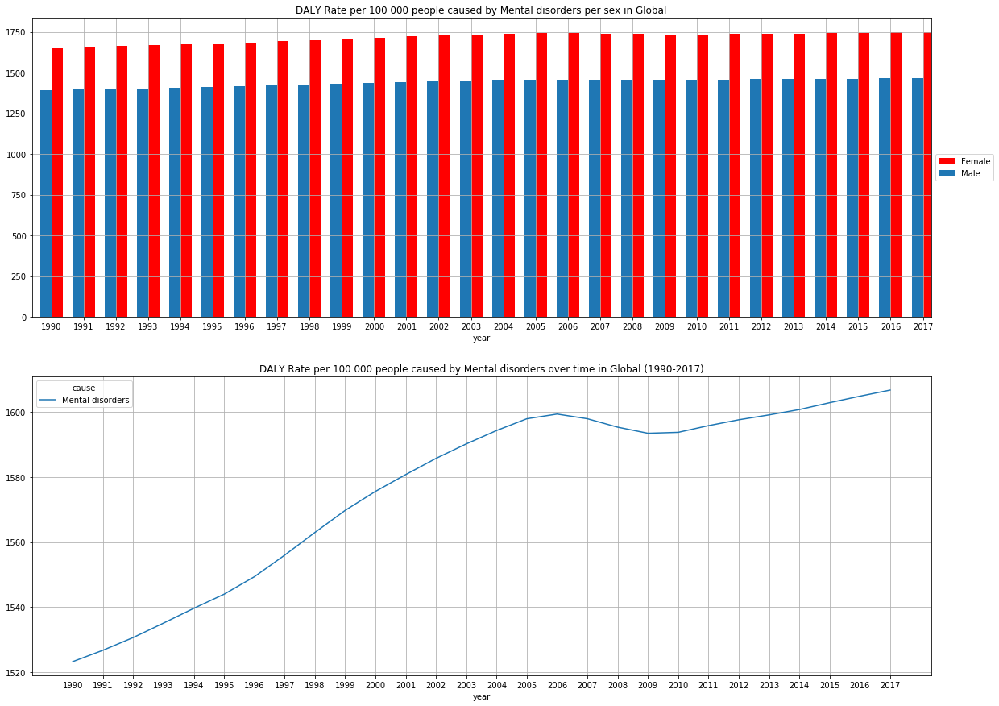

In [94]:
# Let's plot mental illness in total for China to see what it looks like
plot_DALY_per_sex_country(country='Global', location_lvl=Location.GLOBAL, cause_name=Cause.LEVEL_1, measure=Measure.RATE)

We notice that in general, mental illnesses tend to take away healthy years from more women than men (we are comparing for 100 000 people each year) - [studies](https://www.bmj.com/content/354/bmj.i5320) indeed show that women tend to have more mental issues than men. However, when looking at the trend of mental illness over years, we are suprised to find it fall near 2008, since we had the economic recession over these years. However, we can see a general increasing trend.

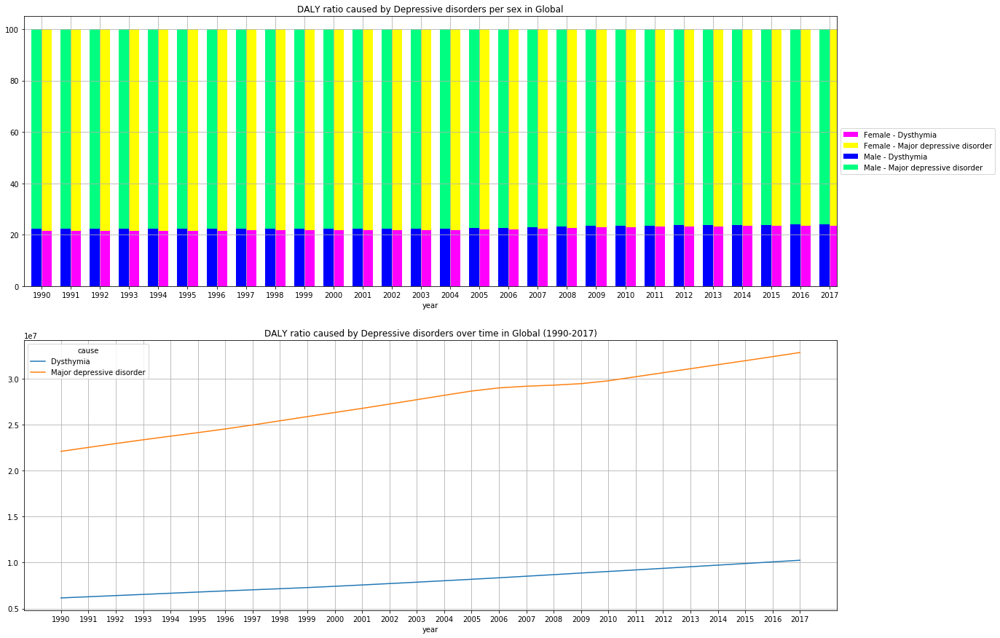

In [95]:
# Let's see what happens for a particular disease, depression, on a global scale
plot_DALY_per_sex_country(country='Global', location_lvl=Location.GLOBAL, cause_name=Cause.DEPRESSION)

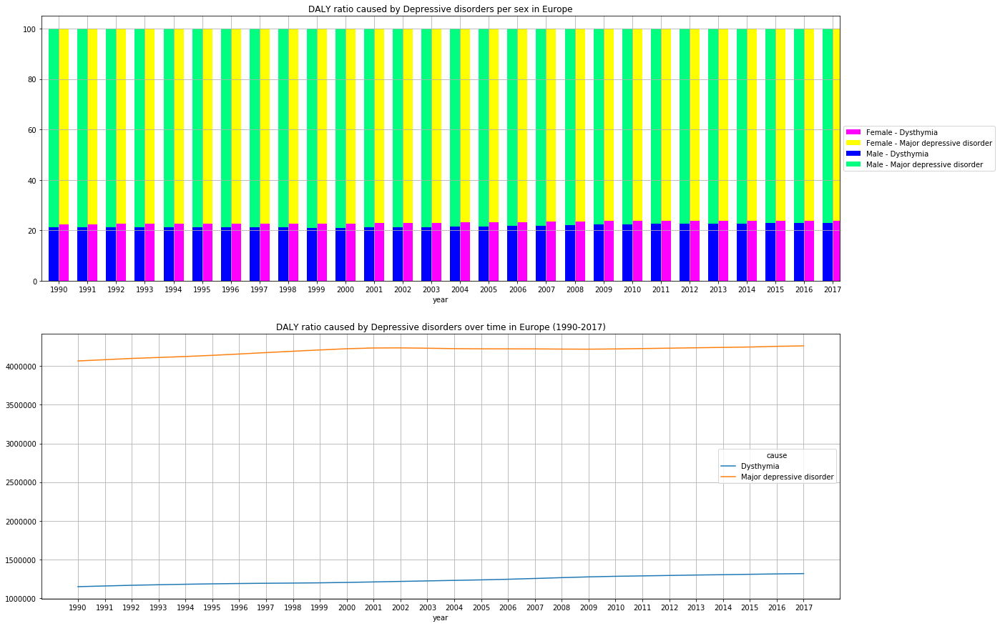

In [96]:
plot_DALY_per_sex_country(country='Europe', location_lvl=Location.CONTINENT, cause_name=Cause.DEPRESSION)

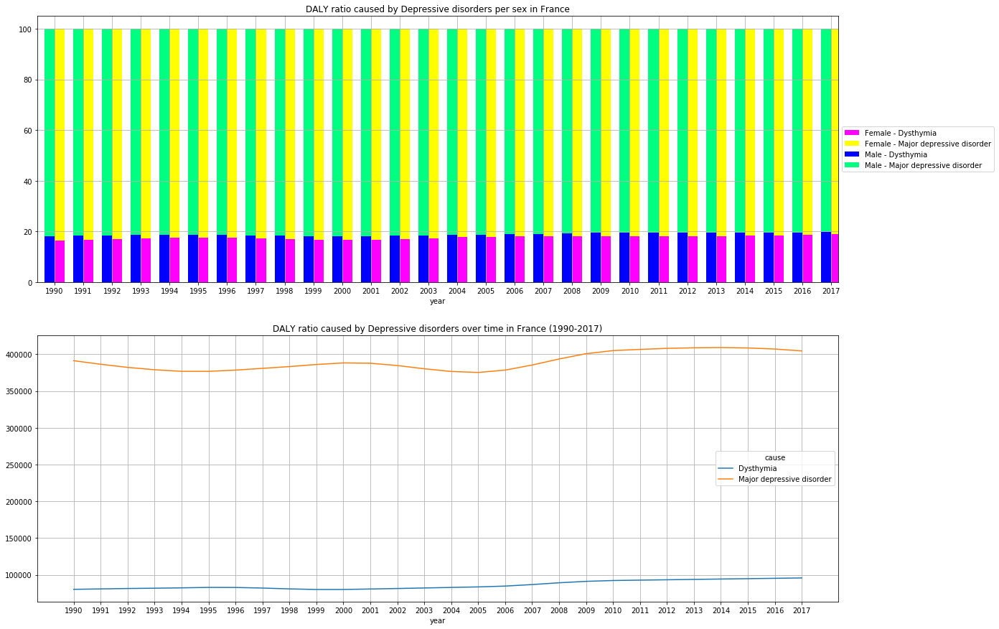

In [97]:
# Let's check for depression in particular in China
# Left colum: Male; Right column: Female
plot_DALY_per_sex_country(country='France', location_lvl=Location.COUNTRY, cause_name=Cause.DEPRESSION)

However, when we pick a particular disease, we don't see any differences globally/in a continent/ in a particular country.

In [98]:
# Let's check for different ages
def plot_DALY_per_age_country(country='China', start_year=2017, end_year=2017, cause_name=Cause.LEVEL_2, measure = Measure.NUMBER, stacked=True):
    """Plot DALY measure for chosen illness per age for a specific country"""
    # Choose measure
    if measure == Measure.NUMBER:
        df_country = DALY_number_per_country[country]
        measure_name = "number"
    elif measure == Measure.RATE:
        df_country = DALY_rate_per_country[country]
        measure_name = "Rate per 100 000 people"
    else:
        df_country = DALY_perc_per_country[country]
        measure_name = "percentage"
        
    # Choose cause
    if cause_name == Cause.LEVEL_1:
        cause = level_1
    elif cause_name == Cause.LEVEL_2:
        cause = level_2
    elif cause_name == Cause.DEPRESSION:
        cause = depression
    else:
        cause = eating
    
    # Set fixed variables for sex and age
    df_country = df_country[(df_country.age != 'All Ages') & (df_country.sex == 'Both')]
    
    # Find years
    years = np.linspace(start_year, end_year, end_year - start_year + 1).astype(int)
    years_dfs = []
    
    # Plot graph per years for each graph
    for year in years:
        years_dfs.append(df_country[(df_country.year == year) & (df_country.cause.isin(cause))].groupby(['age', 'cause'])['val'].sum().unstack())

    df_country_over_years = df_country[ (df_country.cause.isin(level_1))].groupby(['year', 'age'])['val'].sum().unstack()

    fig, axes = plt.subplots(figsize=(20, 10 * len(years) + 5), ncols=1, nrows=len(years) + 1)
    width = 0.5
    
    # Plot for each year
    for i, df in enumerate(years_dfs):
        df.plot.bar(stacked=stacked, ax=axes[i], grid=True, width=width, rot=0, legend=True, title="DAILY {} per age caused by {} in {} ({})".format(measure_name, cause_name.value, country, start_year + i))
    
    df_country_over_years.plot(ax=axes[len(years)], grid=True, colormap=plt.cm.tab20, title="DALY {} caused by {} over time in {} (1990-2017)".format(measure_name, cause_name.value, country))
    # Set manually xtick for each year
    axes[len(years)].xaxis.set_ticks(df_country.year.unique())
    # Put legend outside
    axes[len(years)].legend(loc='center left', bbox_to_anchor=(1, 0.5))

    plt.show()

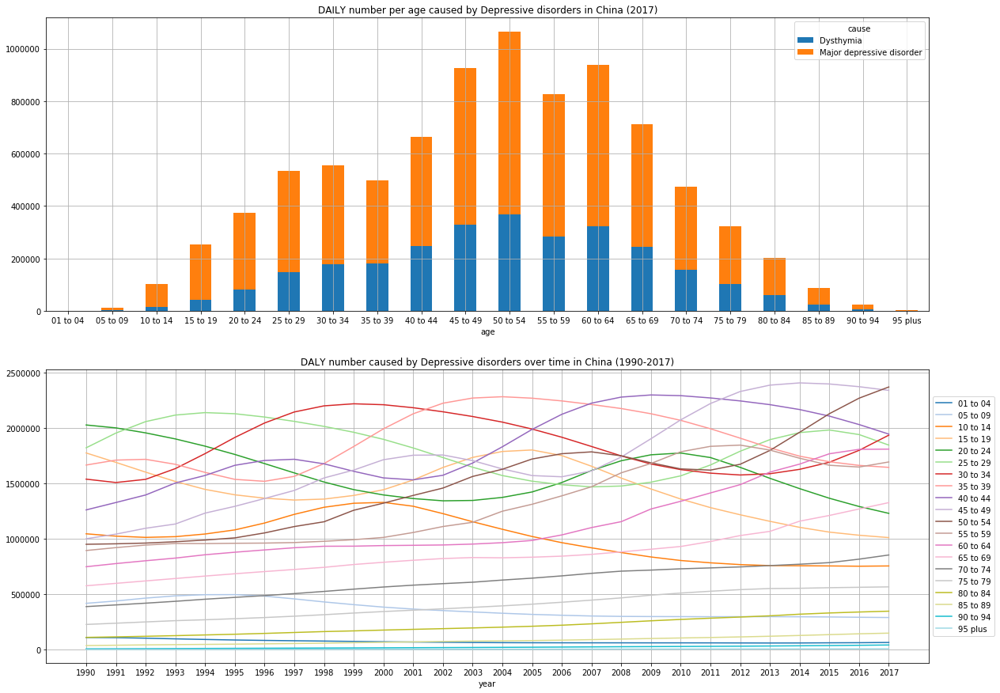

In [99]:
# Let's see the distribution DALY caused by all mental illness Globally over age in 2017
plot_DALY_per_age_country(country='China', cause_name=Cause.DEPRESSION)

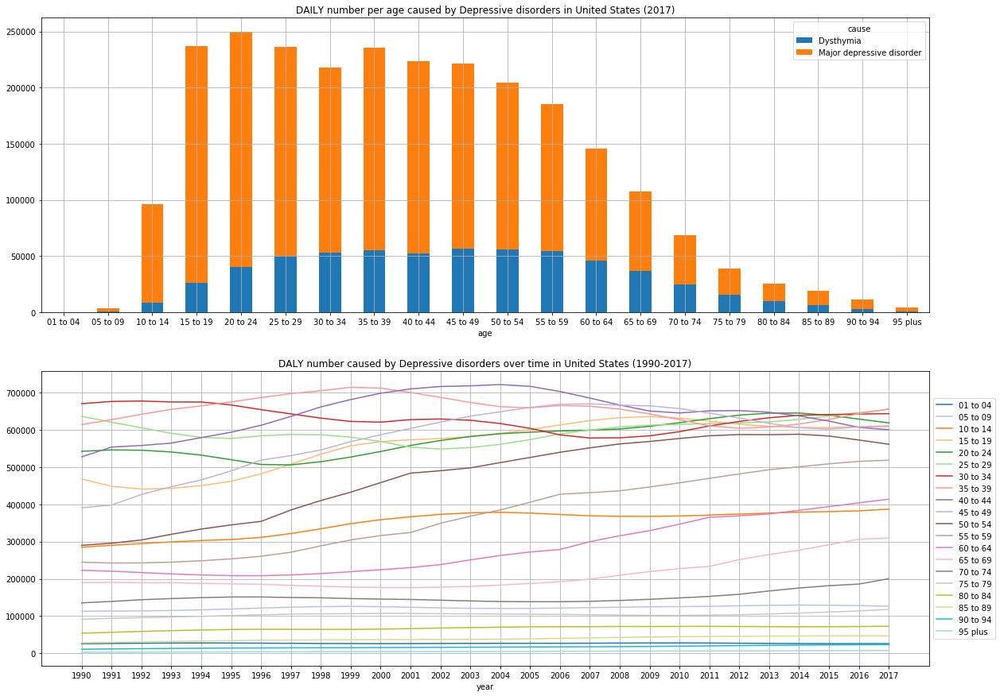

In [100]:
# Let's see the distribution DALY caused by all mental illness in China over age in 2017
plot_DALY_per_age_country(country='United States', cause_name=Cause.DEPRESSION)

As for ages, we can see that it really varies according to countries. We did not have enough time to do a deep analysis, but various sources indicates that it is due to the economic level, the culture, and the values cherished by the country. A deeper analysis will be done at step 3. 

### Prevalence


Prevalence is a statistical concept referring to the total number of cases of a given disease in a specified population at a designated time. 

In [101]:
# Read population data to pandas dataframe
population = pd.read_csv(data_folder + 'Population_2015_2017.csv')

In [102]:
# This topojson file of the world's continents was obtained from https://github.com/deldersveld/topojson WITH PERMISSION under MIT License
continents_topo = json.load(open(r'./topojson/world-continents.json'))
# This topojson file of the wolrd's countries was obtained from https://github.com/simonepri/geo-maps (MIT liscence)
countries_topo = json.load(open(r'./topojson/countries.json'))

In [103]:
# Read prevalence data to pandas dataframe
prevalence = pd.read_csv(saving_folder + "Prevalence.csv", index_col=0, low_memory=False).dropna()
prevalence.year = prevalence.year.astype(int)
prevalence.head()

,measure,location,sex,age,cause,metric,year,val,upper,lower
0,Prevalence,France,Male,1 to 4,Depressive disorders,Number,1990,0.0,0.0,0.0
1,Prevalence,France,Female,1 to 4,Depressive disorders,Number,1990,0.0,0.0,0.0
2,Prevalence,France,Both,1 to 4,Depressive disorders,Number,1990,0.0,0.0,0.0
3,Prevalence,France,Male,1 to 4,Depressive disorders,Rate,1990,0.0,0.0,0.0
4,Prevalence,France,Female,1 to 4,Depressive disorders,Rate,1990,0.0,0.0,0.0


There are three separate metrics to measure mental illness prevalency in the dataframe:

1. Percent - # of population with that specific disease / # of people with all diseases
2. Number - absolute number of people suffering from the disease
3. Rate

In this case, percent does not provide any useful information because we are not comparing mental illness with any other diseases. What we do want to find however, is the share of population with that disease--hence, we will compare the absolute number metric against the population data to identify the percentage of people who have that disease based on the entire population.

In [104]:
# Split the dataset according to 2 useful measures
prevalence_number = prevalence[prevalence.metric == 'Number']
prevalence_rate = prevalence[prevalence.metric == 'Rate']

#### Mental Illness Prevalence from 1990 - 2017

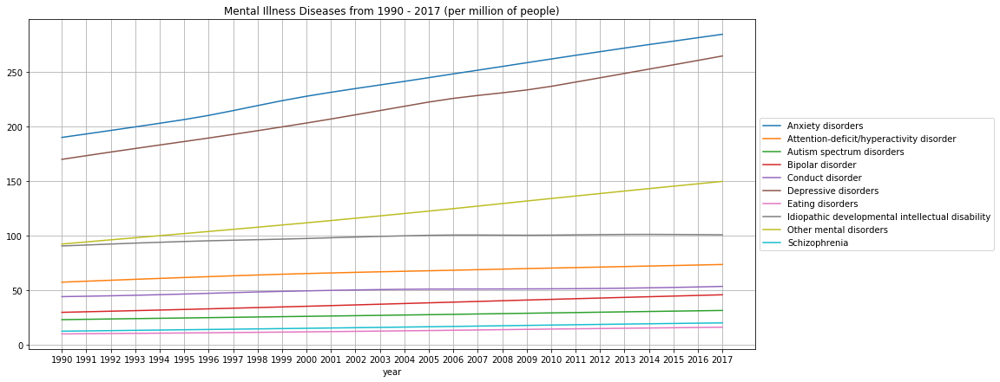

In [105]:
# Since we are comparing how prevalence of mental illness has changed over years, we decided to use absolute number as the metric.
# We filter by only including aggregated rows for all columns except year and cause_name, and we want to group by only level 2 causes.
filtered_data = prevalence_number[(prevalence_number.location == 'Global') & 
                                   (prevalence_number.cause.isin(level_2)) &
                                   (prevalence_number.sex == 'Both') &
                                   (prevalence_number.age == 'All Ages')]

fig, ax = plt.subplots(figsize=(15,7))
plot_data = filtered_data.groupby(['year', 'cause'])['val'].sum().unstack()
plot_data_million = plot_data / ONE_MILLION
plot_data_million.plot(ax=ax, grid=True)
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
ax.xaxis.set_ticks(plot_data.index)
# Prevent using scientific notation
ax.ticklabel_format(useOffset=False, style='plain')
plt.title("Mental Illness Diseases from 1990 - 2017 (per million of people)")
plt.show()

In [106]:
# Numbers of people in the world who attained mental illness from 1990 - 2017 in total
pd.set_option('display.float_format', lambda x: '%.3f' % x)
filtered_data.groupby(['cause'])['val'].sum() / ONE_MILLION

cause
Anxiety disorders                                  6669.354
Attention-deficit/hyperactivity disorder           1855.165
Autism spectrum disorders                           753.334
Bipolar disorder                                   1044.729
Conduct disorder                                   1379.660
Depressive disorders                               6041.749
Eating disorders                                    350.900
Idiopathic developmental intellectual disability   2736.227
Other mental disorders                             3353.860
Schizophrenia                                       444.917
Name: val, dtype: float64

The above graph shows mental illness prevalence globally in the world, per millions of people. We observe that from 1990 - 2017, anxiety disorders and depressive disorders have shown the highest growth in terms of absolute number of people who suffer from the illness, followed by other mental disorders.

#### Mental Illness Prevalence by Continent

Here we wish to explore more in details the prevalence of mentail illness for a particular year, and we picked the most recent year existing in the dataset, 2017. Later in the third step, we plan to perform the following analysis for each year (1990-2017), and the user will be able to see the variation through time.

In [107]:
# We are interested in the most recent data, so we filter by 2017, and aggregate all other columns except location
filtered_data = prevalence_number[(prevalence_number.location.isin(continents)) & 
                                   (prevalence_number.cause.isin(level_1)) &
                                   (prevalence_number.sex == 'Both') &
                                   (prevalence_number.year == 2017) &
                                   (prevalence_number.age == 'All Ages')]

# First filter the population data to have only the information we need.
pop_filtered = population[(population.location_name.isin(continents)) & 
                           (population.sex_name == 'Both') &
                           (population.year_id == 2017) &
                           (population.age_group_name == 'All Ages')]


# Join the prevalency data with population data so we can get the prevalency as a percentage of population
filter_data_perc = pd.merge(filtered_data, pop_filtered, how='inner', left_on='location', right_on='location_name')

# Create new column as prevalency percentage of population
filter_data_perc['prevalency_percentage'] = filter_data_perc['val_x'] / filter_data_perc['val_y'] * 100

# Group data by location_name and get the mean of the 'val'
continent_mental_illness = filter_data_perc.groupby(['location'])['prevalency_percentage'].mean().reset_index()

# Change America to North America in order to prepare for choropleth map graphing
continent_mental_illness.at[1, 'location'] = 'North America'

# Add South America where values are the same as North America
NA_percentage = continent_mental_illness.iloc[1, 1]
continent_mental_illness.loc[5] = ['South America', NA_percentage]

# Change column names for easier understanding
continent_mental_illness.columns = ['continent', 'percentage']

# Sort Continents by Descending Mental Illness Prevalence
continent_mental_illness.sort_values(by=['percentage'], ascending=False)

,continent,percentage
1,North America,13.916
5,South America,13.916
3,Europe,13.576
2,Asia,12.613
0,Africa,11.502
4,Oceania,10.357


We can observe that America have the highest mental illness prevalence measured by percentage of the population, while Oceania has the least.

In [108]:
# Plot the map
world_map = folium.Map(location=[46.8182, 8.2275], tiles='cartodbpositron', zoom_start=1.5)

world_map.choropleth(geo_data=continents_topo,
                     data=continent_mental_illness,
                     topojson='objects.continent',
                     columns=['continent', 'percentage'],
                     key_on='properties.continent',
                     fill_color='GnBu', fill_opacity=1, line_opacity=0.2,
                     legend_name='Share of Population with Mental Illness per Continent in 2017 (%)')

world_map

In [109]:
# Save as HTML so it can render on Github
world_map.save('Mental_Illness_by_Continent.html')

#### Mental Illness Prevalence by Country

Let's see what happens in the same year for the countries we have selected.

In [110]:
# Only use the selcted countries
prevalence_number_country = prevalence_number[prevalence_number.location.isin(countries)]

In [111]:
# We are interested in the most recent data, so we filter by 2017, and aggregate all other columns except location_name
filtered_data = prevalence_number_country[(prevalence_number_country.cause.isin(level_1)) &
                                   (prevalence_number_country.sex == 'Both') &
                                   (prevalence_number_country.year == 2017) &
                                   (prevalence_number_country.age == 'All Ages')]

# First filter the population data to have only the information we need.
pop_filtered = population[(population.location_name.isin(countries)) &
                          (population.sex_name == 'Both') &
                          (population.year_id == 2017) &
                          (population.age_group_name == 'All Ages')]

# Join the prevalency data with population data so we can get the prevalency as a percentage of population
filter_data_perc = pd.merge(filtered_data, pop_filtered, how='left', left_on=['location'], right_on=['location_name'])

# Create new column as prevalency percentage of population
filter_data_perc['prevalency_percentage'] = filter_data_perc['val_x'] / filter_data_perc['val_y'] * 100
filter_data_perc['prevalency_percentage'] = filter_data_perc['prevalency_percentage'].fillna(0)

country_mental_illness = filter_data_perc.groupby(['location'])['prevalency_percentage'].mean().reset_index()

# Change column names for easier understanding
country_mental_illness.columns = ['country', 'percentage']

# Sort Continents by Descending Mental Illness Prevalence
country_mental_illness.sort_values(by=['percentage'], ascending=False)

# Change Russian Federation to Russia in order to prepare for choropleth map graphing
country_mental_illness.loc[(country_mental_illness['country']=='Russian Federation'), 'country'] = 'Russia'

country_mental_illness

,country,percentage
0,Australia,16.749
1,China,11.892
2,France,15.549
3,Russia,11.967
4,United States,16.415


In [112]:
country_mental_illness_dict = country_mental_illness.set_index('country')['percentage'].to_dict()

# Construct a color map customly to be able to insert gray color for not selected countries
color_scale = LinearColormap(['yellow', 'red'], vmin=int(round(min(country_mental_illness_dict.values()),-1)),
                                                         vmax=int(round(max(country_mental_illness_dict.values()),-1)))
step_color_scale = color_scale.to_step(5)
step_color_scale.caption = 'Share of Population with Mental Illness for selected countries in 2017 (%)'

def get_color(feature):
    """Function to put the not chosen countries in gray for better vizualization"""
    value = country_mental_illness_dict.get(feature['properties']['A3'])
    if value is None:
        return '#8c8c8c' # MISSING -> gray
    else:
        return color_scale(value)

country_map = folium.Map(
    location = [50, 15], 
    zoom_start = 4
)

folium.GeoJson(
    data = countries_topo,
    style_function = lambda feature: {
        'fillColor': get_color(feature),
        'fillOpacity': 0.7,
        'color' : 'white',
        'weight' : 0.5,
    }    
).add_to(country_map)

country_map.add_child(step_color_scale)

# Show map
country_map

In [113]:
# Save as HTML so it can render on Github
country_map.save('Mental_Illness_by_Country.html')

We notice that in 2017, the percentage of the population attained by mental disorders in these selected countries don't have a significant difference. This phenomena can maybe be explained by the fact that the living conditions in these countries do not vary significantly (i.e. none of them are very poor/rich compared to others).

#### Mental Illness Prevalence by Age


In [44]:
# These are the ages we will be looking at
prevalence.age = prevalence.age.replace({'5 to 9':'05 to 09', '1 to 4':'01 to 04'})
ages = [i for i in prevalence.age.unique() if i != 'All Ages']

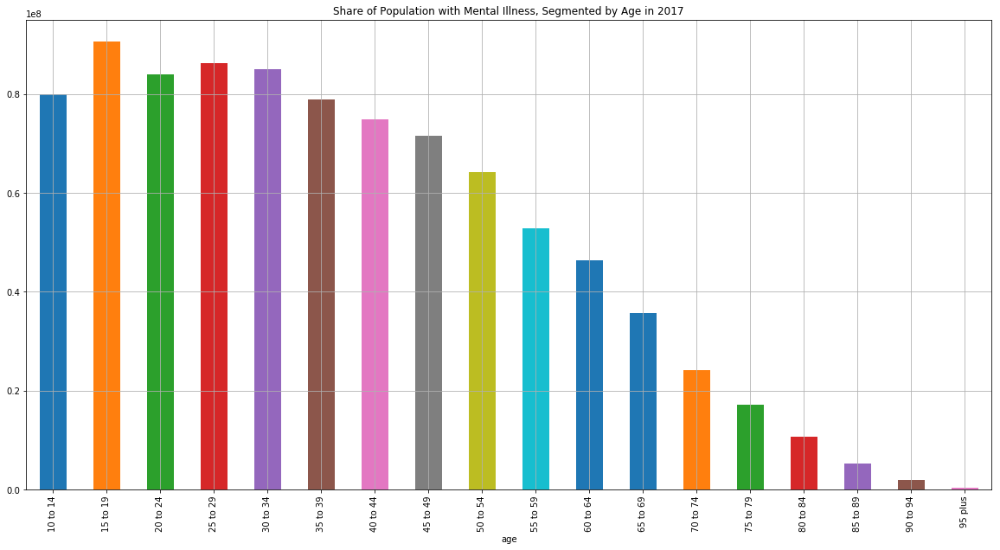

In [45]:
# aggregate all other columns except age
filtered_data = prevalence_number[(prevalence_number.location == 'Global') & 
                                   (prevalence_number.cause.isin(level_1)) &
                                   (prevalence_number.sex == 'Both') &
                                   (prevalence_number.year == 2017) &
                                   (prevalence_number.age.isin(ages))]

# filter population by aggregating all other columns except age
pop_filtered = population[(population.location_name == 'Global') &
                          (population.sex_name == 'Both') &
                          (population.year_id == 2017)]

# Join the prevalency data with population data so we can get the prevalency as a percentage of population
filter_data_perc = pd.merge(filtered_data, pop_filtered, how='inner', left_on=['age'], right_on=['age_group_name'])

# Create new column as prevalency percentage of population
filter_data_perc['prevalency_percentage'] = filter_data_perc['val_x'] / filter_data_perc['val_y'] * 100

# Filter out only the ages in ages list
# age_data = filtered_data[filtered_data.age_name.isin(ages_in_order)]
age_data = filtered_data.groupby(['age'])['val'].mean().reset_index()

# Create mapping to display graph in order of age
mapping = {day: i for i, day in enumerate(ages)}
key = age_data['age'].map(mapping)
age_data = age_data.iloc[key.argsort()]

# Plot prevalency percentage by age
age_data.plot.bar(x='age', y='val', figsize=(20,10), grid=True, legend=False,
                  title="Share of Population with Mental Illness, Segmented by Age in 2017")

Based on the above graph, mental illness peaks during the ages of 15-19, which is often when a person is in high-school, or just beginning university/college. It is possible that the stress of living away from home for the first time or high school drama could be factors that contribute to such a high mental illness percentage. The graph is left-skewed, indicating that mental illness is more prevalent during a person's early stages of life. Mental illness is lowest during 95+ and 1-4 which makes sense because people are less stressed and have fewer responsibilities as a child. 

#### Prevalence by gender

Let's look at the mental illness distribution by gender. Just as an example of analysis, we decided to analyze the distrubtion by gender globally, for all mental illnesses together, in year 2017, for a specific period of age. In step 3, we will replicate the same analysis for each continent and selected country over years.

In [46]:
def plot_prevalence_by_gender(location='Global', year=2017, cause_name=Cause.LEVEL_2, age='All Ages'):
    """Plot prevalence measure by gender"""
    # Choose mental illness level
    if cause_name == Cause.LEVEL_1:
        cause = level_1
    elif cause_name == Cause.LEVEL_2:
        cause = level_2
    elif cause_name == Cause.DEPRESSION:
        cause = depression
    else:
        cause = eating
    
    gender_datas = dict.fromkeys(location)
    
    # filter the data according to input
    gender_data = prevalence_number[(prevalence_number.location == location) & 
                                      (prevalence_number.cause.isin(cause)) &
                                      (prevalence_number.year == year) & 
                                      (prevalence_number.sex != 'Both') &
                                       (prevalence_number.age == age)]

    selected_sizes = np.zeros((2, len(cause)))
    selected_label = np.zeros(len(cause))
    
    fig, axs = plt.subplots(2, 1)
    fig.tight_layout()
    
    # Plot for each gender
    for i, gender in enumerate(gender_data.sex.unique()):
        prevalence_gender = gender_data.loc[gender_data['sex'] == gender]

        gender_gb = prevalence_gender.groupby('cause')['val'].sum().to_frame()

        selected_sizes[i] = gender_gb.val 
        selected_labels = gender_gb.index

        plot = gender_gb.val.plot.pie(y=gender_gb.index, figsize=(10, 15), ax=axs[i], legend=False, autopct='%1.0f%%', 
                            title='Prevalence of causes for mental disease among {} {} ({}, year {})'.format(gender, age, location, year))    
    
    # Rank the proportion of different types of mental disorder
    gender_df = pd.DataFrame(selected_sizes, columns=selected_labels).T
    gender_df.columns = gender_data.sex.unique()

    gender_df['Male'] = gender_df.Male / gender_df.Male.sum() * 100
    gender_df['Female'] = gender_df.Female / gender_df.Female.sum() * 100

    gender_df['Total'] = gender_df.Male + gender_df.Female

    gender_df = gender_df.sort_values(by='Total', ascending=False)
    
    gender_df = gender_df.drop(columns=['Total'], axis=1)
    return gender_df

,Male,Female
cause,,
Anxiety disorders,21.208,33.121
Depressive disorders,20.653,29.944
Other mental disorders,17.831,11.241
Idiopathic developmental intellectual disability,10.859,8.614
Attention-deficit/hyperactivity disorder,10.371,4.014
Conduct disorder,6.943,3.455
Bipolar disorder,4.383,4.395
Autism spectrum disorders,4.745,1.398
Schizophrenia,2.028,1.793


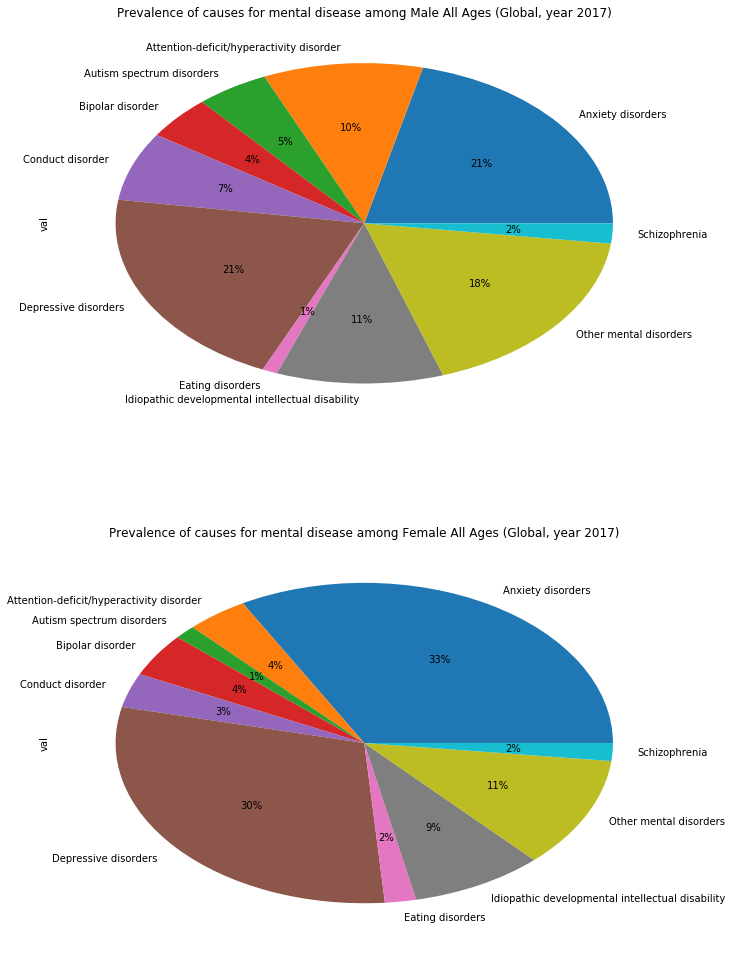

In [47]:
# Plot by gender, for year 2017, per mental disorders
plot_prevalence_by_gender()

We notice that on a global scale, in 2017, the two mental illnesses that most affected both men and women are Depressive Disorders and Anxiety disorders. The proportion in women is in both case much larger than the proportion in men. We also notice that a larger percentage of men tend to have Attention-deficit/hyperactivity disorder than women (10% vs 4%). This corresponds to the result from [this study](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3101894/), where it says that "Males are generally more likely to be diagnosed with ADHD than females, with a male to female ratio of approximately 4:1 in community samples."

,Male,Female
cause,,
Anxiety disorders,23.618,36.163
Depressive disorders,22.725,32.304
Other mental disorders,21.153,12.081
Attention-deficit/hyperactivity disorder,9.439,2.892
Bipolar disorder,5.668,5.855
Conduct disorder,4.963,2.124
Autism spectrum disorders,5.640,1.343
Idiopathic developmental intellectual disability,3.467,2.615
Eating disorders,1.304,2.969


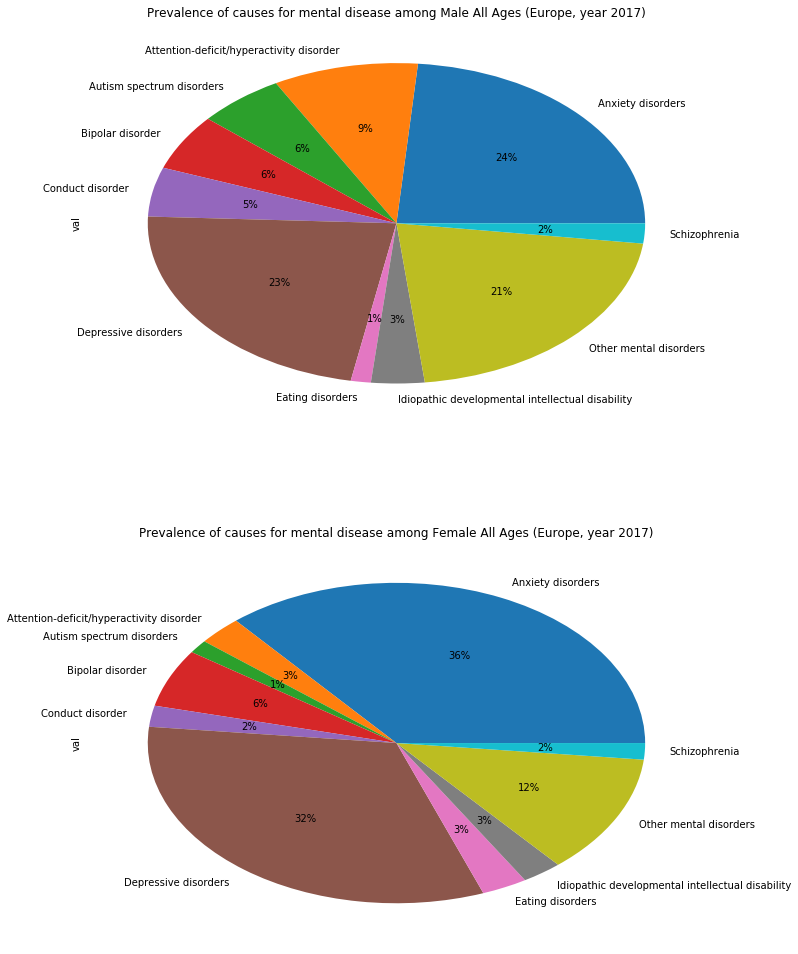

In [48]:
# Let's check in a continent
plot_prevalence_by_gender(location='Europe')

,Male,Female
cause,,
Anxiety disorders,27.268,44.108
Depressive disorders,22.395,29.514
Other mental disorders,20.240,9.723
Bipolar disorder,5.702,5.239
Attention-deficit/hyperactivity disorder,8.124,2.023
Autism spectrum disorders,5.799,1.043
Conduct disorder,4.831,1.694
Eating disorders,1.504,3.237
Idiopathic developmental intellectual disability,2.157,2.040


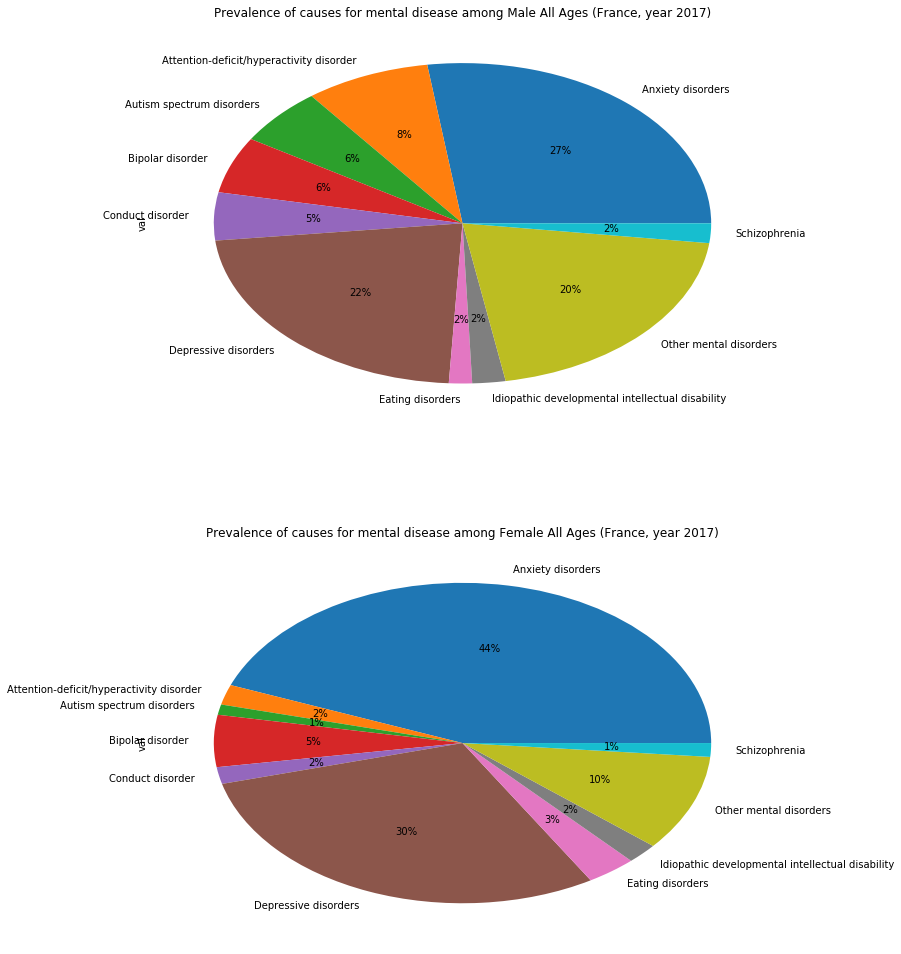

In [49]:
# Let's check in a country
plot_prevalence_by_gender(location='France')

We see that the general trend doesn't change, but there are differences based on the regions. Due to time constraints, we did not manage to do the complete analysis for each country. In step 3, we will need to do deeper researches concerning each location.

# MileStone 3: Data Story

In [47]:
# Imports for visualization

import random
#import viz
import pycountry as pyc

from sklearn import cluster
from sklearn import metrics
from sklearn import linear_model
from imp import reload
from matplotlib import pyplot as plt

import plotly
import plotly.plotly as py

import plotly.graph_objs as go
from plotly.graph_objs import Choropleth, Bar, Scatter

import plotly.offline as offline
from plotly.offline import init_notebook_mode, iplot, plot
from IPython.display import display, HTML

# Set credentials
plotly.tools.set_credentials_file(username='judy.gong', api_key='QOp2xvVMCnAfhRk8EALn')

In [18]:
# Get population of countries
import pandas as pd
from os import listdir
from os.path import isfile, join

reading_folder = "./data/population/"
files = [f for f in listdir(reading_folder) if isfile(join(reading_folder, f))]

pdfs = []
for file in files:
    print("Reading {} ...".format(file))
    pdfs.append(pd.read_csv(reading_folder + file))
    
# Merge into one huge data matrix
pd_all = pd.concat(pdfs).reset_index(drop=True)
print(pd_all.shape)

Reading IHME_GBD_2017_POP_1990_1994_Y2018M11D08.CSV ...
Reading IHME_GBD_2017_POP_2005_2009_Y2018M11D08.CSV ...
Reading IHME_GBD_2017_POP_2010_2014_Y2018M11D08.CSV ...
Reading IHME_GBD_2017_POP_2000_2004_Y2018M11D08.CSV ...
Reading IHME_GBD_2017_POP_2015_2017_Y2018M11D08.CSV ...
Reading IHME_GBD_2017_POP_1995_1999_Y2018M11D08.CSV ...
(5239668, 13)


In [19]:
glob = ['Global']
continents = ['Asia', 'Europe', 'Oceania', 'America', 'Africa']
countries = [ i for i in sorted(pd_all.location_name.unique()) if ((not i in continents) and (i != 'Global'))]

### SET THE LOCATION YOU WANT HERE ###
locations = countries
locations_name = "countries"

In [20]:
# drop id columns
to_drop = [col for col in pd_all.columns if "id" in col and 'year' not in col]
print(to_drop)

pd_all = pd_all.drop(columns = to_drop, axis=1)

['location_id', 'sex_id', 'age_group_id', 'measure_id']


In [21]:
pd_loc = pd_all[pd_all.location_name.isin(locations)]
pd_loc.head()

,location_name,sex_name,age_group_name,year_id,measure_name,metric_name,val,upper,lower
1995,World Bank Regions,Male,Under 5,1990,Population,Number,3.306335e+08,3.376261e+08,3.232812e+08
1996,World Bank Regions,Male,Under 5,1991,Population,Number,3.310686e+08,3.381109e+08,3.234004e+08
1997,World Bank Regions,Male,Under 5,1992,Population,Number,3.299796e+08,3.372514e+08,3.220843e+08
1998,World Bank Regions,Male,Under 5,1993,Population,Number,3.281942e+08,3.356586e+08,3.199204e+08
1999,World Bank Regions,Male,Under 5,1994,Population,Number,3.264209e+08,3.345524e+08,3.179063e+08


## Mental Illness Prevalence - World Map

In [59]:
# Load the data
prevalence_country = pd.read_csv(data_folder + '2017_map_data.csv')

# Filter data to only show prevalence data, and aggregate cause, sex and age
filtered_data = prevalence_country[(prevalence_country.measure == 'Prevalence') &
                                   (prevalence_country.cause == 'Mental disorders') &
                                   (prevalence_country.sex == 'Both') &
                                   (prevalence_country.age == 'All Ages')]

# Filter population data to aggregate by sex and age
pop_filtered = pd_loc[(pd_loc.sex_name == 'Both') &
                      (pd_loc.age_group_name == 'All Ages')]

# Join the prevalency data with population data so we can get the prevalency as a percentage of population
filter_data_perc = pd.merge(filtered_data, pop_filtered, how='inner', left_on=['location', 'year'], right_on=['location_name', 'year_id'])

# Create new column as prevalency percentage of population
filter_data_perc['prevalency_percentage'] = filter_data_perc['val_x'] / filter_data_perc['val_y'] * 100
filter_data_perc['prevalency_percentage'] = filter_data_perc['prevalency_percentage'].fillna(0)

country_mental_illness = filter_data_perc.groupby(['location', 'year'])['prevalency_percentage'].mean().reset_index()

# Change column names for easier understanding
country_mental_illness.columns = ['country', 'year', 'percentage']

# Sort countries by descending mental illness prevalence
country_mental_illness.sort_values(by=['percentage'], ascending=False)

# Change Russian Federation to Russia in order to prepare for choropleth map graphing
country_mental_illness.loc[(country_mental_illness['country']=='Russian Federation'), 'country'] = 'Russia'

# Load country codes csv file that maps country name to code
country_codes = pd.read_csv(data_folder + 'country_codes.csv')

# Combine prevalence data with country codes in order to prepare for mapping
country_mental_illness = pd.merge(country_mental_illness, country_codes, how='inner')

country_mental_illness.head()

,country,year,percentage,code
0,Afghanistan,1990,16.285,AFG
1,Afghanistan,1991,16.551,AFG
2,Afghanistan,1992,16.802,AFG
3,Afghanistan,1993,16.970,AFG
4,Afghanistan,1994,16.981,AFG


In [60]:
# Drop Northern Marina Islands because its data is an outlier and has an effect on the rest of the graph
country_mental_illness = country_mental_illness[country_mental_illness.country != 'Northern Mariana Islands']

In [61]:
# Code for plotting world map
def world_map_figure(title,
                     title_colorscale,
                     frames_title,
                     df,
                     locations_col,
                     txt_fn,
                     zmin,
                     zmax,
                     colorscale,
                     showscale=True):
    figure = {
        'data': world_map_data(title_colorscale, zmin, zmax, colorscale, showscale),
        'layout': world_map_layout(title, frames_title),
        'frames': world_map_frames(frames_title, df, locations_col, txt_fn)
    }
    return figure


def world_map_layout(title, frames_title):
    sliders_dict = {
        'active': 0,
        'yanchor': 'top',
        'xanchor': 'left',
        'currentvalue': {
            'font': {'size': 20},
            'prefix': '',
            'visible': True,
            'xanchor': 'right'
        },
        'transition': {'duration': 300, 'easing': 'cubic-in-out'},
        'pad': {'b': 10, 't': 50},
        'len': 0.9,
        'x': 0.1,
        'y': 0,
        'steps': []
    }

    for name in frames_title:
        slider_step = {'args': [
            [name],
            {'frame': {
                'duration': 300,
                'redraw': False
            },
                'mode': 'immediate',
                'transition': {'duration': 300}
            }
        ],
            'label': name,
            'method': 'animate'
        }
        sliders_dict['steps'].append(slider_step)

    layout = {
        'title': title,
        'width': 1080,
        'height': 720,
        'geo': {
            'showframe': True,
            'showcoastlines': False,
            'showland': True,
            'landcolor': 'gray',
            'projection': {
                'type': 'Mercator'
            },
            'bgcolor': 'rgba(0, 0, 0, 0)',
        },
        'sliders': [sliders_dict],
        'updatemenus': [{
            'buttons': [
                {
                    'args': [None, {'frame': {'duration': 500, 'redraw': False},
                                    'fromcurrent': True,
                                    'transition': {'duration': 300, 'easing': 'quadratic-in-out'}}],
                    'label': 'Play',
                    'method': 'animate'
                },
                {
                    'args': [[None], {'frame': {'duration': 0, 'redraw': False}, 'mode': 'immediate',
                                      'transition': {'duration': 0}}],
                    'label': 'Pause',
                    'method': 'animate'
                }
            ],
            'direction': 'left',
            'pad': {'r': 10, 't': 87},
            'showactive': False,
            'type': 'buttons',
            'x': 0.1,
            'xanchor': 'right',
            'y': 0,
            'yanchor': 'top',
        }],
        'paper_bgcolor': 'rgba(0, 0, 0, 0)',
        'plot_bgcolor': 'rgba(0, 0, 0, 0)',
        'font': dict(color='#ffffff')
    }

    return layout


def world_map_data(title_colorscale, zmin, zmax, colorscale, showscale=True):
    data = [{
        'type': 'choropleth',
        'zmin': zmin,
        'zmax': zmax,
        'showscale': showscale,
        'colorscale': colorscale,
        'reversescale': False,
        'marker': {
            'line': {
                'color': 'rgb(180,180,180)',
                'width': 0.5
            }
        },
        'colorbar': {
            'title': title_colorscale
        },
    }]
    return data


def world_map_frames(frames_title, df, locations_col, txt_fn):
    frames = []
    for name in frames_title:
        frame_data = {
            'locations': df[locations_col],
            'z': df[name],
            'text': df[locations_col].apply(txt_fn),
        }
        frame = {
            'data': [frame_data],
            'name': name,
        }
        frames.append(frame)
    return frames

In [62]:
# Set connected = True
init_notebook_mode(connected=True)

# Change data to be in the form of pivot table
df_target = pd.pivot_table(country_mental_illness, values='percentage', index=['code'], columns=['year'], aggfunc=np.median)

# Get the minimum and maximum values from the data - this will be used for the scale of the map
zmin_tone_target = df_target.min().max()
zmax_tone_target = df_target.max().min()

# Get list of unique years from data
unique_years = country_mental_illness.year.unique().tolist()

In [63]:
# Define and plot map
figure_target = world_map_figure(title='Mental Illness Prevalence Across the World',
                                      title_colorscale='Share of Population<br>With Mental Illness (%)',
                                      frames_title=unique_years,
                                      df=df_target.reset_index(),
                                      locations_col='code',
                                      txt_fn=lambda code: pyc.countries.get(alpha_3=code).name,
                                      zmin=zmin_tone_target,
                                      zmax=zmax_tone_target,
                                      colorscale = [[0,"#CFF09E"],[0.25,"#A8DBA8"],[0.5,"#79BD9A"],[0.75,"#3B8686"],[1,"#0B486B"]])

iplot(figure_target, validate=False, filename='mental_illness_map_over_years')

In [1]:
# Plot and save graph as HTML
#plotly.offline.plot(figure_target, validate=False, filename='mental_illness_map_over_years.html')

# Functions for ploting offline

In [48]:
def save_html(html_str, title):
    Html_file = open("plotly/" + title + ".html","w")
    Html_file.write(html_str)
    Html_file.close()
    
    
def make_figure(title, values, x_axis=None, y_axis=None, sliders=True, playButtons = True):
    # make figure
    figure = {
        'data': [],
        'layout': {},
        'frames': []
    }

    # fill in most of layout
    if (x_axis is not None) and (y_axis is not None):
        figure['layout']['xaxis'] = x_axis
        figure['layout']['yaxis'] = y_axis
    figure['layout']['hovermode'] = 'closest'
    if sliders:
        figure['layout']['sliders'] = {
            'args': [
                'transition', {
                    'duration': 400,
                    'easing': 'cubic-in-out'
                }
            ],
            'initialValue': str(values[0]),
            'plotlycommand': 'animate',
            'values': values,
            'visible': True
        }
    
    if playButtons:
        figure['layout']['updatemenus'] = [
            {
                'buttons': [
                    {
                        'args': [None, {'frame': {'duration': 500, 'redraw': True},
                                 'fromcurrent': True, 'transition': {'duration': 300, 'easing': 'quadratic-in-out'}}],
                        'label': 'Play',
                        'method': 'animate'
                    },
                    {
                        'args': [[None], {'frame': {'duration': 0, 'redraw': True}, 'mode': 'immediate',
                        'transition': {'duration': 0}}],
                        'label': 'Pause',
                        'method': 'animate'
                    }
                ],
                'direction': 'left',
                'pad': {'r': 10, 't': 87},
                'showactive': False,
                'type': 'buttons',
                'x': 0.1,
                'xanchor': 'right',
                'y': 0,
                'yanchor': 'top'
            }
        ]
    figure['layout']['title'] = title
    figure['layout']['font'] = dict(color='#ffffff')
    
    return figure

def make_figure_black(title, values, x_axis=None, y_axis=None, sliders=True, playButtons = True):
    figure = make_figure(title, values, x_axis, y_axis, sliders, playButtons)
    figure['layout']['font'] = dict(color='#000000')
    
    return figure

def make_sliders(prefix = 'Year: '):
    sliders_dict = {
        'active': 0,
        'yanchor': 'top',
        'xanchor': 'left',
        'currentvalue': {
            'font': {'size': 15},
            'prefix': prefix,
            'visible': True,
            'xanchor': 'right'
        },
        'transition': {'duration': 300, 'easing': 'cubic-in-out'},
        'pad': {'b': 10, 't': 50},
        'len': 0.9,
        'x': 0.1,
        'y': 0,
        'steps': []
    }
    return sliders_dict


def make_plot(sliders_dict, figure, function, years, df, locations, bar = False):
    years = sorted(years)
    for year in years:
        if bar:
            data_dict = function(year, df, locations[0], level_2)
        else:
            data_dict = function(years[0], year, df, locations)
#         print(data_dict)
        # Only append first year
        if year == years[0]:
            figure['data'] = data_dict

        # Make frames
        frame = {'data': data_dict, 'name': str(year)}
#         frame['data'] = data_dict
#         print(frame)
        figure['frames'].append(frame)

        # Slider step
        slider_step = {'args': [
            [str(year)],
            {'frame': {'duration': 300, 'redraw': True},
             'mode': 'immediate',
           'transition': {'duration': 300}}
         ],
         'label': str(year),
         'method': 'animate'}
        sliders_dict['steps'].append(slider_step)

    figure['layout']['sliders'] = [sliders_dict]
    figure['layout']['paper_bgcolor']='rgba(0,0,0,0)'
    figure['layout']['plot_bgcolor']='rgba(0,0,0,0)'
    if bar:
        figure['layout']['barmode'] ='stack'
    

    return figure


# Deaths Rates per Country Plots

In [51]:
def deaths_per_year(start_year, end_year, df, locations):
    years = np.linspace(start_year, end_year, end_year - start_year + 1, dtype=np.int32)

    continents = df.Continent.unique().tolist()
    x = dict.fromkeys(df.Continent.unique().tolist())
    y = dict.fromkeys(df.Continent.unique().tolist())
    text = dict.fromkeys(df.Continent.unique().tolist())
    opacity = dict.fromkeys(df.Continent.unique().tolist())

    for continent in continents:
        x[continent] = []
        y[continent] = []
        text[continent] = []
        opacity[continent] = []

    for year in years:
        df_y = df[df.Year == year]
        for continent in continents:
            df_continent = df_y[df_y.Continent == continent]
            x[continent].extend(list(df_continent['Number']))
            y[continent].extend(list(df_continent['Rate']))
            text[continent].extend(list(df_continent['Country']))
            
            if year == end_year:
                opacity[continent].extend([1 for i in df_continent.Number])
            else:
                opacity[continent].extend([0.5 for i in df_continent.Number])

    data_dicts = []
    for continent in continents:
        data_dict = {
            'x': x[continent],
            'y': y[continent],
            'mode': 'markers',
            'text': text[continent],
            'marker': {
                'opacity': opacity[continent]
            },
            'name': continent
        }
        data_dicts.append(data_dict)

    return data_dicts

def make_plot_deaths(sliders_dict, figure, function, years, df, locations, bar = False):
    years = sorted(years)
    for year in years:
        if bar:
            data_dict = function(year, df, locations[0], level_2)
        else:
            data_dict = function(years[0], year, df, locations)
#         print(data_dict)
        # Only append first year
        if year == years[0]:
            figure['data'] = data_dict

        # Make frames
        frame = {'data': data_dict, 'name': str(year)}
#         frame['data'] = data_dict
#         print(frame)
        figure['frames'].append(frame)

        # Slider step
        slider_step = {'args': [
            [str(year)],
            {'frame': {'duration': 300, 'redraw': True},
             'mode': 'immediate',
           'transition': {'duration': 300}}
         ],
         'label': str(year),
         'method': 'animate'}
        sliders_dict['steps'].append(slider_step)

    figure['layout']['sliders'] = [sliders_dict]
    figure['layout']['paper_bgcolor']='rgba(0,0,0,0)'
    figure['layout']['plot_bgcolor']='rgba(0,0,0,0)'
    if bar:
        figure['layout']['barmode'] ='stack'

    return figure


#### Deaths Rate VS Death Number

In [59]:
init_notebook_mode(connected=True)

deaths = pd.read_csv("./data/death_rate_vs_number.csv", index_col = 0)

# Rename Columns
deaths = deaths.rename(index=str, columns={'subregion':'Country', 'state':'Continent', 'INC': 'Number', 'PRE2': 'Rate', 
                                            'model': 'Year'})
deaths['Country'] = deaths.index

# Sort years 
df = deaths.copy()
years = sorted(df.Year.unique().tolist())
years_str = results = list(map(str, years))

# Add Sliders and Titles
sliders = make_sliders()
figure_deaths = make_figure_black('Deaths rate over 100K people vs Total Deaths Number due to Mental Illness', years_str,
                            dict(title = 'Deaths Number', type='log', autorange=True), #x
                            dict(title = 'Deaths Rate (over 100K)', type='log', autorange=True)) #y


# Plot the graph
figure_deaths = make_plot_deaths(sliders, figure_deaths, deaths_per_year, years, df, [])
iplot(figure_deaths, validate=True)

# Save to local 
#html_str = plot(figure_deaths, include_plotlyjs=False, output_type='div')
#save_html(html_str, "deaths_rate_number")


In [60]:
death_prevalence = pd.read_csv("./data/prevalence_vs_death_rate.csv", index_col = 0)
death_prevalence = death_prevalence.drop(['year_id', 'val','location_name'], axis=1)

# Rename Columns
death_prevalence.columns=['Country','Continent', 'Year', 'Number', 'Rate']

df_2 = death_prevalence.copy()
years_2 = sorted(df_2.Year.unique().tolist())
years_str_2 = results = list(map(str, years_2))

# Add Sliders and Titles
sliders = make_sliders()
figure_deaths2 = make_figure_black('Deaths caused by Mental Disorders (per 100K) vs Prevalence of Mental Disorders (per 100K)', 
                             years_str_2,
                            dict(title = 'Prevalence (over 100K)', type='log', range = [4, 4.4]), #x
                            dict(title = 'Deaths Rate (over 100K)', type='log', autorange = True)) #y 

major_countries = ['China', 'India', 'Japan', 'South Korea','North Korea',
                   'France', 'Germany', 'Spain', 'Italy','Brazil', 'Romania', 'Belgium',
                   'Democratic Republic of the Congo', 'Central African Republic','Liberia',
                   'Canada','United States', 'United Kingdom', 'Mexico', 'Panama', 'Colombia', 'Bahamas',
                   'Egypt', 'Morocco', 'Kenya', 'Sudan', 'Algeria','Nigeria', 'Kazakhstan',
                   'Turkey', 'Iceland', 'Finland', 'Norway', 'Switzerland','Netherlands', 'Sweden',
                   'Cambodia', 'Togo', 'Benin', 'Haiti', 'Iraq','Iran', 'Isreal','Syria',
                   'Denmark', 'Nicaragua', 'New Zealand', 'Fiji', 'Puerto Rico',
                   'Russian Federation', 'Australia', 'Argentina', 'Bolivia', 'Chile','Mongolia']

random_countries = random.sample(death_prevalence.Country.tolist(), 30)
plot_countries = major_countries + random_countries

death_prevalence = death_prevalence[(death_prevalence.Country.isin(plot_countries))]

# Plot
figure_deaths_prevalence = make_plot_deaths(sliders, figure_deaths2, deaths_per_year, years, df_2, [])
iplot(figure_deaths_prevalence, validate=False)

# Save to local 
#html_str = plot(figure_deaths_prevalence, include_plotlyjs=False, output_type='div')
#save_html(html_str, "deaths_prevalence_countries")


# AGE

#### Number of Mental Health Related Deaths for various causes


In [74]:
deaths_new = pd.read_csv("country_data/death_new.csv", index_col=0, low_memory=False).dropna()
deaths_new.year = deaths_new.year.astype(int)
deaths_new.head()

# Split into 3 dataframes for different causes
deaths_alcohol = deaths_new[deaths_new.cause == 'Alcohol use disorders']
deaths_drug = deaths_new[deaths_new.cause == 'Drug use disorders']
deaths_eating = deaths_new[deaths_new.cause == 'Eating disorders']

# Sort based on years in ascending order
deaths_alcohol = deaths_alcohol.sort_values(by='year', ascending=True)
deaths_drug = deaths_drug.sort_values(by='year', ascending=True)
deaths_eating = deaths_eating.sort_values(by='year', ascending=True)

# Drop unused columns 
deaths_alcohol = deaths_alcohol.drop(columns=['location','sex','age','upper','lower','metric'], axis=1)
deaths_drug = deaths_drug.drop(columns=['location','sex','age','upper','lower','metric'], axis=1)
deaths_eating = deaths_eating.drop(columns=['location','sex','age','upper','lower','metric'], axis=1)

joint_causes = deaths_alcohol.drop(columns=['cause'], axis=1)

joint_causes['val2'] = deaths_drug.val
joint_causes['val3'] = deaths_eating.val

# Rename columns
joint_causes.columns = ['year', 'Alcohol Disorder', 'Drug Disorder', 'Eating Disorder']

#joint_causes.to_csv('1. joint_causes_over_year.csv', index=False)

joint_causes.head()

,year,Alcohol Disorder,Drug Disorder,Eating Disorder
measure,,,,
Deaths,1990,112563.850843,89377.763758,380.498608
Deaths,1991,118066.317874,93044.774952,390.837561
Deaths,1992,127683.630163,97459.716704,404.295040
Deaths,1993,141205.600747,102251.521315,423.419338
Deaths,1994,151962.292851,107053.712600,441.203147


#### Number of Death and Death Rates for each country

In [75]:
continents_country = pd.read_csv("country_data/continents_country_map.csv", low_memory=False).dropna()
deaths_number_rates = pd.read_csv("country_data/deaths_number_rates.csv", index_col=0, low_memory=False).dropna()

# Map countries to continent
continents_country = continents_country[['Country', 'Continent']]
continents_country_dict = continents_country.set_index('Country')['Continent'].to_dict()

# Select metric Number and Rates
deaths_number = deaths_number_rates[deaths_number_rates.metric == 'Number']
deaths_rate = deaths_number_rates[deaths_number_rates.metric == 'Rate']

# Group the dataset by location and year 
deaths_number_gb = deaths_number.groupby(['location', 'year'])['val'].sum().unstack()
deaths_rate_gb = deaths_rate.groupby(['location', 'year'])['val'].sum().unstack()

# Filter the dataset to keep only the entries that has a country-continent mapping
filtered_data_num = deaths_number_gb[(deaths_number_gb.index.isin(continents_country.Country))]
filtered_data_rate = deaths_rate_gb[(deaths_rate_gb.index.isin(continents_country.Country))]

# Create Continents and Country List for easier accessing
continents = [continents_country_dict.get(i) for i in filtered_data_num.index]
countries = filtered_data_num.index

# Transpose dataframe for better visualization
filtered_data_num = filtered_data_num.T
filtered_data_rate = filtered_data_rate.T

df_cuts = [filtered_data_num[[col]] for col in filtered_data_num.columns]
df_rate = [filtered_data_rate[[col]] for col in filtered_data_rate.columns]

for idx in range(len(df_cuts)):
    df = df_cuts[idx]
    df['Countries'] = countries[idx]
    df['Continents'] = continents[idx]
    df['Rates'] = df_rate[idx]

    df.columns =['Number', 'Countries', 'Continents', 'Rates']
    df_cuts[idx] = df
    
deaths_df = pd.concat(df_cuts, axis=0)

#deaths_df.to_csv('2. number_rate_over_years.csv', index=True)

deaths_df.head()


/anaconda3/lib/python3.6/site-packages/ipykernel/__main__.py:33: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

/anaconda3/lib/python3.6/site-packages/ipykernel/__main__.py:34: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

/anaconda3/lib/python3.6/site-packages/ipykernel/__main__.py:35: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view

,Number,Countries,Continents,Rates
year,,,,
1990,113.214549,Afghanistan,Asia,0.949466
1991,121.628321,Afghanistan,Asia,0.969836
1992,132.822541,Afghanistan,Asia,0.993350
1993,146.258179,Afghanistan,Asia,1.021592
1994,160.391228,Afghanistan,Asia,1.051277


In [125]:
prevalence_age = pd.read_csv("./data/Last_data/Prevalence.csv", index_col=0, low_memory=False).dropna()
prevalence_age.year = prevalence_age.year.astype(int)

prevalence_number = prevalence_age[prevalence_age.metric == 'Number']
prevalence_rate = prevalence_age[prevalence_age.metric == 'Rate']


# Filter by only prevalence and aggregate all other columns
prevalence_number = prevalence_number[(prevalence_number.sex == 'Both') &
                                   (prevalence_number.age != 'All Ages') &
                                   (prevalence_number.year == 2017)]

# Merge with population dataset
prevalence_age = pd.merge(prevalence_number[['location', 'sex', 'age', 'cause', 'year', 'val']],
                         population[['location_name', 'sex_name', 'age_group_name', 'year_id', 'val']],
                         how='left', left_on=['location', 'sex', 'age', 'year'],
                         right_on=['location_name', 'sex_name', 'age_group_name', 'year_id'])

# Calculate population percentage for each age group
prevalence_age['age_perc'] = prevalence_age['val_x'] / prevalence_age['val_y'] * 100



In [127]:
major_locations = ['China', 'United States', 'France', 'Australia', 'Russian Federation', 'Global']

# Percentage of people in different age ranges with mental disorder for 5 major countries (2017)
prev_age_maj_locations = prevalence_age[prevalence_age.location.isin(major_locations) & 
                                       (prevalence_age.cause.isin(level_1))]

prev_age_maj_locations.head()

,location,sex,age,cause,year,val_x,location_name,sex_name,age_group_name,year_id,val_y,age_perc
42,Global,Both,1 to 4,Mental disorders,2017,13886730.407,Global,Both,1 to 4,2017,542719811.040,2.559
43,Global,Both,5 to 9,Mental disorders,2017,44152327.408,Global,Both,5 to 9,2017,661202731.876,6.678
44,Global,Both,10 to 14,Mental disorders,2017,79897969.189,Global,Both,10 to 14,2017,636265176.631,12.557
45,Global,Both,15 to 19,Mental disorders,2017,90519182.997,Global,Both,15 to 19,2017,616460726.179,14.684
46,Global,Both,20 to 24,Mental disorders,2017,83958487.441,Global,Both,20 to 24,2017,604513365.437,13.889


In [126]:
major_disorders = ['Schizophrenia', 'Depressive disorders', 'Anxiety disorders', 'Eating disorders', 'Bipolar disorder']

# Percentage of people in different age ranges diagnosed with each of the 5 major mental illness(2017)
prev_age_maj_disorders = prevalence_age[prevalence_age.cause.isin(major_disorders) &
                                        (prevalence_age.location == 'Global')]

prev_age_maj_disorders.head()

,location,sex,age,cause,year,val_x,location_name,sex_name,age_group_name,year_id,val_y,age_perc
63,Global,Both,1 to 4,Schizophrenia,2017,0.000,Global,Both,1 to 4,2017,542719811.040,0.000
64,Global,Both,5 to 9,Schizophrenia,2017,0.000,Global,Both,5 to 9,2017,661202731.876,0.000
65,Global,Both,10 to 14,Schizophrenia,2017,35723.950,Global,Both,10 to 14,2017,636265176.631,0.006
66,Global,Both,15 to 19,Schizophrenia,2017,301379.053,Global,Both,15 to 19,2017,616460726.179,0.049
67,Global,Both,20 to 24,Schizophrenia,2017,1140438.411,Global,Both,20 to 24,2017,604513365.437,0.189


## Correlation Between Mental Illness Prevalence & Life Satisfaction

In [66]:
# Load Prevalence data
prevalence_country = pd.read_csv(data_folder + '2017_map_data.csv')

# Filter by only prevalence and aggregate all other columns
filtered_data = prevalence_country[(prevalence_country.measure == 'Prevalence') &
                                   (prevalence_country.cause.isin(level_1)) &
                                   (prevalence_country.sex == 'Both') &
                                   (prevalence_country.age == 'All Ages')]

# Filter population data
pop_filtered = pd_loc[(pd_loc.sex_name == 'Both') &
                      (pd_loc.age_group_name == 'All Ages')]

# Join the prevalency data with population data so we can get the prevalency as a percentage of population
filter_data_perc = pd.merge(filtered_data, pop_filtered, how='left', left_on=['location', 'year'], right_on=['location_name', 'year_id'])

# Create new column as prevalency percentage of population
filter_data_perc['prevalency_percentage'] = filter_data_perc['val_x'] / filter_data_perc['val_y'] * 100
filter_data_perc['prevalency_percentage'] = filter_data_perc['prevalency_percentage'].fillna(0)

country_mental_illness = filter_data_perc.groupby(['location', 'year', 'val_y'])['prevalency_percentage'].mean().reset_index()

# Change column names for easier understanding
country_mental_illness.columns = ['country', 'year', 'population', 'percentage']

# Sort Continents by Descending Mental Illness Prevalence
country_mental_illness.sort_values(by=['percentage'], ascending=False)

# Change Russian Federation to Russia in order to prepare for choropleth map graphing
country_mental_illness.loc[(country_mental_illness['country']=='Russian Federation'), 'country'] = 'Russia'

country_mental_illness.head()

,country,year,population,percentage
0,Afghanistan,1990,10006380.469,16.285
1,Afghanistan,1991,10395526.379,16.551
2,Afghanistan,1992,12278224.887,16.802
3,Afghanistan,1993,14309843.655,16.970
4,Afghanistan,1994,15042264.188,16.981


In [67]:
# Get life satisfaction data
happiness = pd.read_csv("./data/" + 'happiness_global.csv')
happiness.head()

,Entity,Code,Year,World Happiness Report 2016 (Cantril Ladder (0=worst; 10=best))
0,Afghanistan,AFG,2008,3.724
1,Afghanistan,AFG,2009,4.402
2,Afghanistan,AFG,2010,4.758
3,Afghanistan,AFG,2011,3.832
4,Afghanistan,AFG,2012,3.783


In [68]:
# Join happiness data with country_mental_illness
country_happiness = pd.merge(country_mental_illness, happiness, how='inner', left_on=['country', 'year'], right_on=['Entity', 'Year'])

# Drop unnecessary columns and rename for easier understanding
country_happiness = country_happiness.drop(['Entity', 'Code', 'Year'], axis = 1)
country_happiness.columns = ['country', 'year', 'population', 'mental_illness_prevalence', 'life_satisfaction']

# Get mapping of countries and continents
continent_country = pd.read_csv(data_folder + 'Countries_Continents.csv')
country_happiness = pd.merge(country_happiness, continent_country, how='inner', left_on=['country'], right_on=['Country'])
country_happiness = country_happiness.drop(['Country'], axis=1)

country_happiness.head()

,country,year,population,mental_illness_prevalence,life_satisfaction,Continent
0,Afghanistan,2008,24622253.821,15.483,3.724,Asia
1,Afghanistan,2009,25375442.092,15.452,4.402,Asia
2,Afghanistan,2010,26294224.220,15.434,4.758,Asia
3,Afghanistan,2011,27388166.965,15.410,3.832,Asia
4,Afghanistan,2012,28340362.398,15.379,3.783,Asia


In [69]:
# Drop 2005 year values because there are too few countries
country_happiness = country_happiness[country_happiness.year != 2005]

# Correlation of mental illness prevalence and life satisfaction
corr = country_happiness['mental_illness_prevalence'].corr(country_happiness['life_satisfaction'])
print('Pearson Correlation Coefficient for Mental Illness Prevalence and Life Satisfaction:', corr)

Pearson Correlation Coefficient for Mental Illness Prevalence and Life Satisfaction: 0.477109821019


In [71]:
# Code to plot graph

dataset = country_happiness

years = []
for year in dataset['year']:
    if year not in years:
        years.append(year)
years = sorted(years, key=int)    
years = [str(x) for x in years]
        
# make list of continents
continents = []
for continent in dataset['Continent']:
    if continent not in continents:
        continents.append(continent)
# make figure
figure = {
    'data': [],
    'layout': {},
    'frames': []
}

# fill in most of layout
figure['layout']['xaxis'] = {'range': [2, 8], 'title': 'Life Satisfaction (0 - Worst, 10 - Best)'}
figure['layout']['yaxis'] = {'range': [0, 20],'title': 'Share of Population with Mental Illness (%)'}
figure['layout']['hovermode'] = 'closest'
figure['layout']['title'] = 'Mental Illness Prevalence vs Life Satisfaction'
figure['layout']['paper_bgcolor'] = 'rgba(0,0,0,0)'
figure['layout']['plot_bgcolor'] = 'rgba(0,0,0,0)'
figure['layout']['sliders'] = {
    'args': [
        'transition', {
            'duration': 400,
            'easing': 'cubic-in-out'
        }
    ],
    'initialValue': '2008',
    'plotlycommand': 'animate',
    'values': years,
    'visible': True
}
figure['layout']['updatemenus'] = [
    {
        'buttons': [
            {
                'args': [None, {'frame': {'duration': 500, 'redraw': False},
                         'fromcurrent': True, 'transition': {'duration': 300, 'easing': 'quadratic-in-out'}}],
                'label': 'Play',
                'method': 'animate'
            },
            {
                'args': [[None], {'frame': {'duration': 0, 'redraw': False}, 'mode': 'immediate',
                'transition': {'duration': 0}}],
                'label': 'Pause',
                'method': 'animate'
            }
        ],
        'direction': 'left',
        'pad': {'r': 10, 't': 87},
        'showactive': False,
        'type': 'buttons',
        'x': 0.1,
        'xanchor': 'right',
        'y': 0,
        'yanchor': 'top'
    }
]

sliders_dict = {
    'active': 0,
    'yanchor': 'top',
    'xanchor': 'left',
    'currentvalue': {
        'font': {'size': 20},
        'prefix': 'Year:',
        'visible': True,
        'xanchor': 'right'
    },
    'transition': {'duration': 300, 'easing': 'cubic-in-out'},
    'pad': {'b': 10, 't': 50},
    'len': 0.9,
    'x': 0.1,
    'y': 0,
    'steps': []
}

# make data
year = 2006
for continent in continents:
    dataset_by_year = dataset[dataset['year'] == year]
    dataset_by_year_and_cont = dataset_by_year[dataset_by_year['Continent'] == continent]

    data_dict = {
        'x': list(dataset_by_year_and_cont['life_satisfaction']),
        'y': list(dataset_by_year_and_cont['mental_illness_prevalence']),
        'mode': 'markers',
        'text': list(dataset_by_year_and_cont['country']),
        'marker': {
            'sizemode': 'area',
            'sizeref': 200000,
            'size': list(dataset_by_year_and_cont['population'])
        },
        'name': continent
    }
    figure['data'].append(data_dict)
    
# make frames
for year in years:
    frame = {'data': [], 'name': str(year)}
    for continent in continents:
        dataset_by_year = dataset[dataset['year'] == int(year)]
        dataset_by_year_and_cont = dataset_by_year[dataset_by_year['Continent'] == continent]

        data_dict = {
            'x': list(dataset_by_year_and_cont['life_satisfaction']),
            'y': list(dataset_by_year_and_cont['mental_illness_prevalence']),
            'mode': 'markers',
            'text': list(dataset_by_year_and_cont['country']),
            'marker': {
                'sizemode': 'area',
                'sizeref': 200000,
                'size': list(dataset_by_year_and_cont['population'])
            },
            'name': continent
        }
        frame['data'].append(data_dict)

    figure['frames'].append(frame)
    slider_step = {'args': [
        [year],
        {'frame': {'duration': 300, 'redraw': False},
         'mode': 'immediate',
       'transition': {'duration': 300}}
     ],
     'label': year,
     'method': 'animate'}
    sliders_dict['steps'].append(slider_step)

    
figure['layout']['sliders'] = [sliders_dict]

iplot(figure)

In [72]:
# Save graph

def save_html(html_str, title):
    Html_file = open("plotly/" + title + ".html","w")
    Html_file.write(html_str)
    Html_file.close()
    
#html_str = plot(figure, include_plotlyjs=False, output_type='div')
#save_html(html_str, "mental_illness_life_satisfaction_transparent")

## Correlation Between Depression Prevalence & Education/Employment

In [85]:
# import data to pandas dataframe
mental_health_data = pd.read_csv(data_folder + 'OECD_Mental_Health_Stats.csv')

In [86]:
# Clean and Prepare Data

# Drop redundant columns that depend on another column
# Also drop 'Measure', 'Flag Codes', and 'Flags' columns because they are not needed in our data exploration
mental_health_data = mental_health_data.drop(['ISC11A', 'COUNTRY', 'MEASURE', 'Reference year', 'SEX', 'PIAAC_CATEGORY', 'INDICATOR', 'AGE', 'Measure', 'Flag Codes', 'Flags'], axis=1)

# Drop rows where Value is NaN, and drop columns Measure, Flag Codes, and Flags (because they indicate that value is NaN)
mental_health_data = mental_health_data.dropna(subset = ['Value'])

# Rename some columns for easier understanding
mental_health_data = mental_health_data.rename(columns={'ISCED-A 2011': 'Education', 'Category': 'Employment', 'YEAR': 'Year'})

# Convert categorical columns to type category
cat_cols = ['Country', 'Education', 'Gender', 'Age', 'Employment', 'Indicator']
mental_health_data[cat_cols] = mental_health_data[cat_cols].astype('category')

In [91]:
# Create dataframe that only contains depression data
depressed_aggregated = mental_health_data[(mental_health_data.Indicator == 'Percentage of adults who report having depression') &
                                          (mental_health_data['Gender'] == 'Total') &
                                          (mental_health_data['Country'] == 'Unweighted average (Unitary countries)')]

In [92]:
# Group by education and employment
education_employment_depression_prevalence = depressed_aggregated.groupby(['Education', 'Employment'])['Value'].mean().reset_index()
education_employment_depression_prevalence

,Education,Employment,Value
0,All levels of education,Active,6.299
1,All levels of education,Employed,5.462
2,All levels of education,Total,8.069
3,Below upper secondary education,Active,8.900
4,Below upper secondary education,Employed,6.964
5,Below upper secondary education,Total,12.280
6,Tertiary education,Active,4.892
7,Tertiary education,Employed,4.472
8,Tertiary education,Total,5.654
9,Upper secondary and post-secondary non-tertiar...,Active,6.673


As can be seen from above, there is a negative correlation between depression prevalence and education/employment. Depression prevalence decreases as education level and employment increases.

### Hypothesis Testing - Difference of Depression Prevalence between Active & Employed

In [81]:
# Filter data to aggregate columns
employment_depression_prevalence = mental_health_data[(mental_health_data.Indicator == 'Percentage of adults who report having depression') &
                                          (mental_health_data['Gender'] == 'Total') &
                                          (mental_health_data['Education'] == 'All levels of education')]
employment_depression_prevalence.groupby(['Employment'])['Value'].mean().reset_index()

,Employment,Value
0,Active,6.144
1,Employed,5.323
2,Level (0/1),nan
3,Level (2),nan
4,Level (3),nan
5,Level (4/5),nan
6,Total,7.909


In [89]:
# P-Value using internal scipy function

from scipy.stats import ttest_ind

cat1 = employment_depression_prevalence[employment_depression_prevalence['Employment']=='Employed']
cat2 = employment_depression_prevalence[employment_depression_prevalence['Employment']=='Active']

ttest_ind(cat1['Value'], cat2['Value'])

Ttest_indResult(statistic=-1.8448816686405078, pvalue=0.066903510100898067)

In [90]:
# P-Value calculated manually - double check to make sure this is same as scipy value

from scipy import stats

# Define sample size
N = 81

# Define the values from the two categories - employed and active
a = cat1.Value
b = cat2.Value

## Calculate the Standard Deviation
#Calculate the variance to get the standard deviation

#For unbiased max likelihood estimate we have to divide the var by N-1, and therefore the parameter ddof = 1
var_a = a.var(ddof=1)
var_b = b.var(ddof=1)

#total std deviation
s = np.sqrt((var_a + var_b)/2)

## Calculate the t-statistics
t = (a.mean() - b.mean())/(s*np.sqrt(2/N))

## Compare with the critical t-value
#Degrees of freedom
df = 2*N - 2

#p-value after comparison with the t 
p = stats.t.cdf(t,df=df)


print("t = " + str(t))
print("p = " + str(2*p))

t = -1.84488166864
p = 0.0669035101009


With a 10% signifance level (or 90% confidence level), we can reject the null hypothesis and conclude that there is a difference in depression prevalence between active and employed groups.